# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [2]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
from datetime import date
from datetime import datetime
import os
import pickle
import sys

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

import gc
from tensorflow.keras import backend as K

## Open Data

In [4]:
resolution = 48

data_file_names = [
                    "bolivar_2020_thresh_0.8_1_negatives",
                    "amazonas_2020_thresh_0.5_2_negatives",
                    "amazonas_2020_thresh_0.8_sumbsample_3_positives",
                    "MinesPos2018-2020Sentinel_points",
                    "bolivar_2020_thresh_0.8_sumbsample_5_positives",
                    "full_amazon_v9_negatives",
                    "v2.6_amazon_thresh_0.8_negatives",
                    "v2.0_bolivar_negatives",
                    # "v2.1.1_bolivar_negatives",
                    # "riverbank_negatives"

              ]

data_file_names = [
                    'amazonas_2020_thresh_0.8_sumbsample_3_positives',
                    'MinesPos2018-2020Sentinel_points',
                    'bolivar_2020_thresh_0.8_sumbsample_5_positives',
                    'full_amazon_v9_negatives',
                    'v2.4_amazon_positives',
                    'v2.6_amazon_thresh_0.8_negatives',
                    'v2.0_bolivar_negatives',
                    # 'riverbank_negatives','v2.6_amazon_negatives','v2.6_amazon_negatives_v2''v2.1.1_bolivar_negatives','v2.4_amazonas_negatives','v2.4_amazon_negatives','bolivar_2020_thresh_0.8_1_negatives','amazonas_2020_thresh_0.5_2_negatives',
              ]



#start_dates = ['2020-01-01', '2021-01-01', '2022-01-01']
#end_dates = ['2021-01-01', '2022-01-01', '2023-01-01']
start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]
data_files = [f'{fn}_{sd}_{ed}_patch_arrays.pkl' for fn in data_file_names for sd, ed in zip(start_dates, end_dates)]
label_files = [f.split('s.pkl')[0] + '_labels.pkl' for f in data_files]


data_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    # "riverbank_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_arrays.pkl",
    ]
label_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    # "riverbank_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
]

patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/16 [00:00<?, ?it/s]

3310 samples loaded
1102 positive samples
2208 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

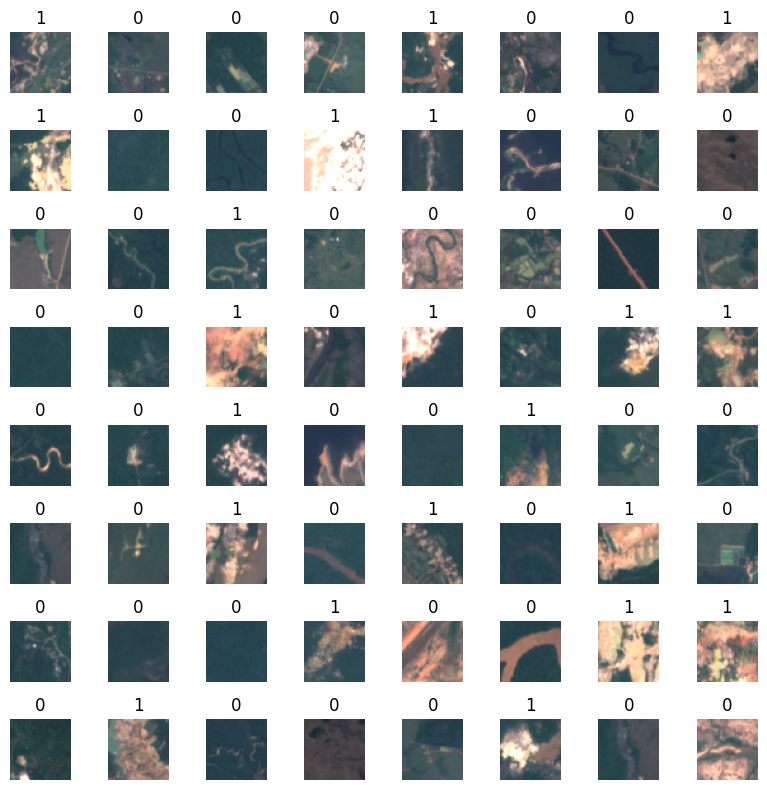

In [5]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [6]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7198333333333333].


100.0% of data below brightness limit


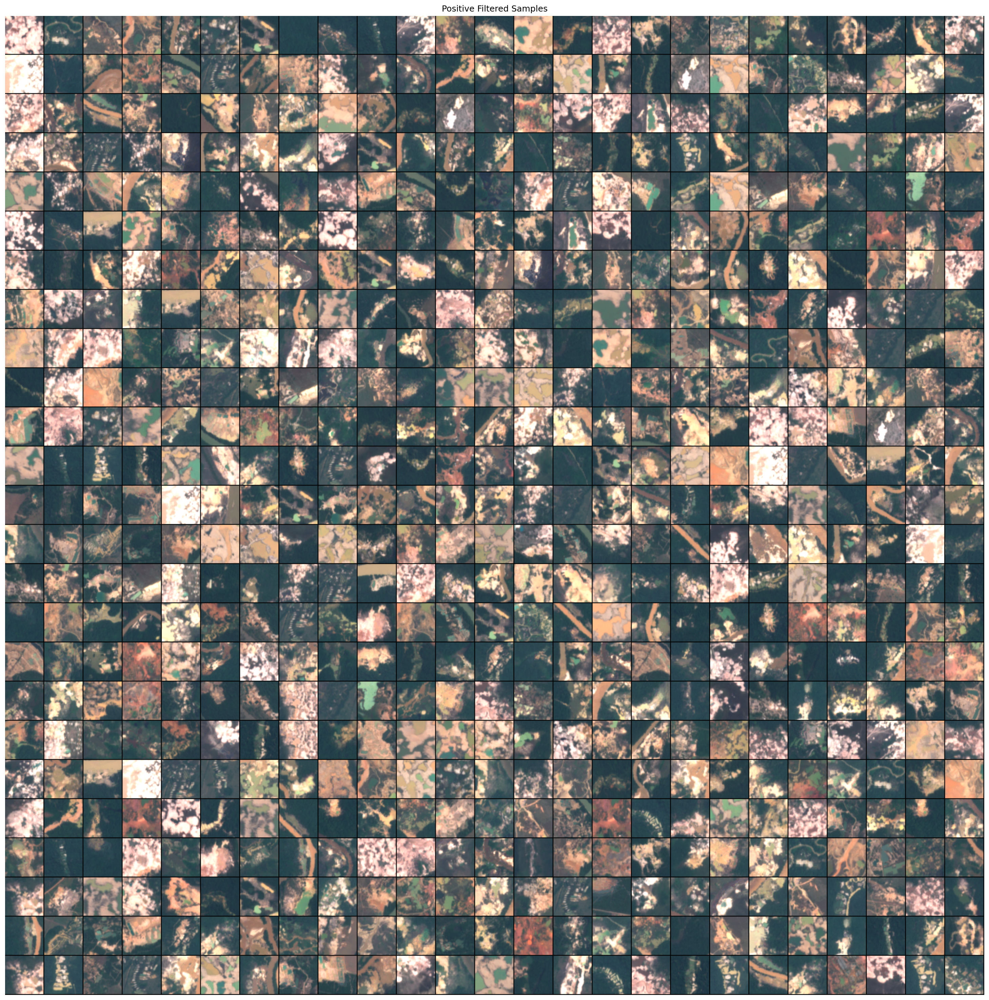

In [7]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..3.9053333333333335].


100.0% of data below brightness limit


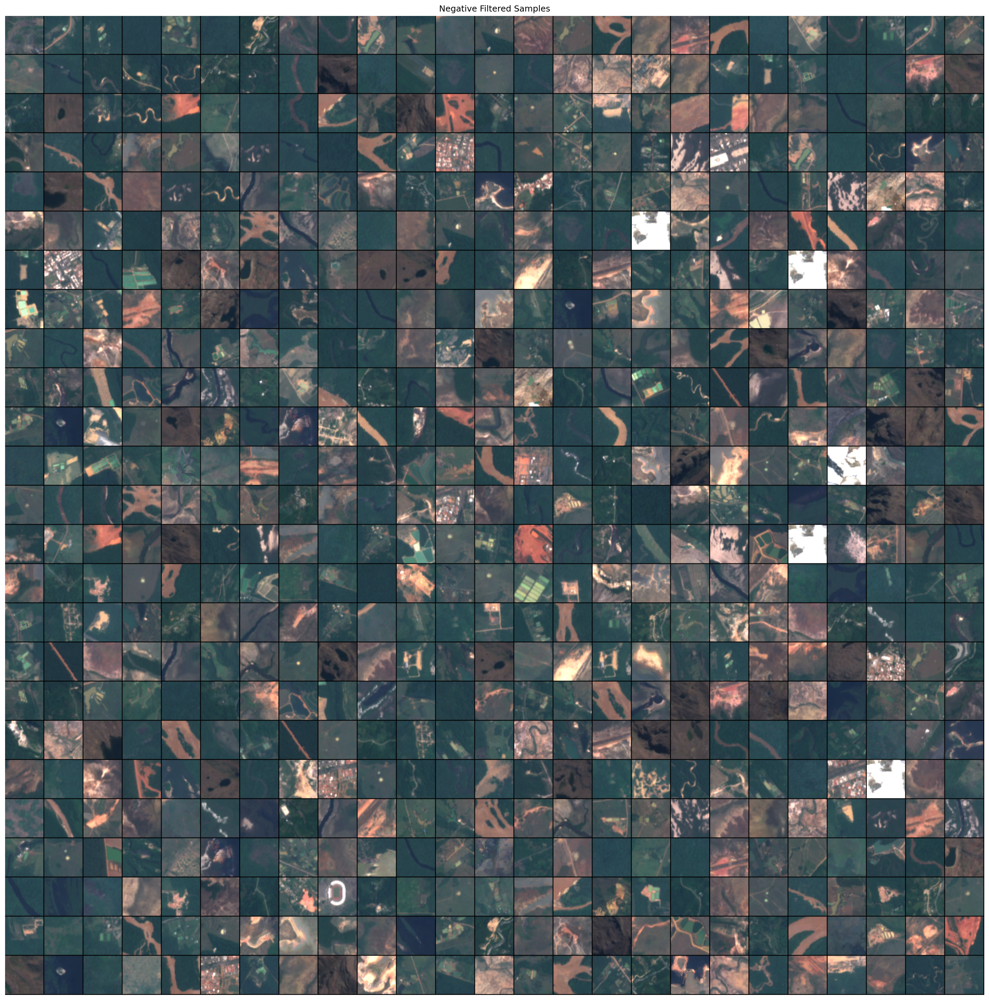

In [8]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [9]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (3310, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

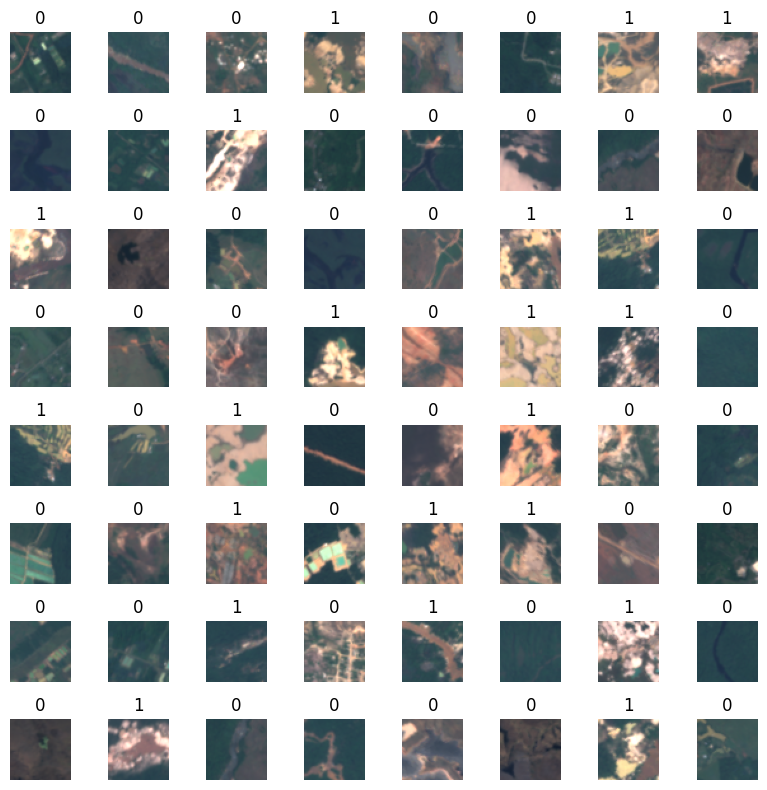

In [10]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [11]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

In [12]:
hiper_params_original_test = {"class_weight" : {0: 1, 1: 1},
                              "batch_size" : 32,
                              "epochs" : 160,
                              "test_size" : 0.3
                           }   

### Entrenamiento
- Entrenamos el modelo original para 5 semillas distintas. Se elige el mejor modelo para poder compararlo con los demás.
- Total de modelos construidos = 5
- Tiempo total 2s * 160 epocas * 5 modelos = 27 mins

In [13]:
%%time

# Descripcion de esta prueba
desc_test = "modelo_y_parametros_originales"
hiperparametros = [hiper_params_original_test]

# Inicializamos para dar nombre a todos los outputs que se escriban
hora_exec = datetime.now().strftime('%Y-%m-%d_%H-%M')

# Creamos el nombre del directorio para guardar los modelos finales
path_prueba_actual = f"../notebooks/best_models/{desc_test}_{hora_exec}/"
os.makedirs(path_prueba_actual, exist_ok=True)

# Inicializamos las variables dónde almacenaremos los resultados de cada uno de los modelos generados
df_scratch = pd.DataFrame()

#Eliminamos los csvs generados en ejecuciones anteriores
dl_utils.limpia_directorios("aux_path")

# Recorremos la lista de configuraciones distinta generada anteriormente
for id_hiperparams,hiperparams in enumerate(hiperparametros):
    for semilla in range(0,5):  

        # Limpiamos la carpeta donde se guardan los modelos
        dl_utils.limpia_directorios("weigths")

        # Definimos hiperparámetros asociados a la ejecución actual
        batch_size = hiperparams["batch_size"]
        epochs = hiperparams["epochs"]
     
        # Dividimos el conjunto de imágenes en train y test
        seed = np.random.randint(0, 2000,1)[0]
        hiperparams["semilla"] = seed
        keras.utils.set_random_seed(int(seed))
        x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=hiperparams["test_size"], random_state=123)

        # Definimos y compilamos los modelos
        scratch_original_model_and_params = models.scratch_original_model(x_train.shape[1:])

        # Modelo por defecto empleando los mismos parámetros que el original.
        scratch_original_model_and_params_results = scratch_original_model_and_params.fit(
            datagen.flow(x_train, y_train),
            batch_size=batch_size,
            epochs=epochs,
            validation_data=(x_test, y_test),
            verbose=1,
            shuffle=True,
            class_weight={0: 1, 1: 1},
        )

        # Evaluamos el modelo y lo comparamos con el mejor almacenado.  
        hora_actual = datetime.now().strftime('%Y-%m-%d_%H-%M')
        df_scratch,          save_df_scratch          = dl_utils.get_df_best_model(scratch_original_model_and_params,x_test,y_test,f"scratch_original_model_and_params_{desc_test}_",df_scratch,hora_actual)

        # Si el modelo actual es mejor que el almacenado, guardamos su información.      
        if save_df_scratch:
            best_scratch_original_model_and_params = scratch_original_model_and_params
            best_scratch_original_model_and_params_results = scratch_original_model_and_params_results
            best_scratch_original_model_and_params__hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_original_model_and_params_{desc_test}_{hora_actual}.csv')
        
        del scratch_original_model_and_params
        del scratch_original_model_and_params_results
        K.clear_session()
        gc.collect()        

# Guardamos el mejor modelo
dl_utils.save_models(best_scratch_original_model_and_params,best_scratch_original_model_and_params_results,best_scratch_original_model_and_params__hiperparams,hora_exec,f'scratch_original_model_and_params_{desc_test}',path_prueba_actual)

# Movemos los archivos asociados a los resultados
dl_utils.obtener_tablas_resultado(path_prueba_actual,[best_scratch_original_model_and_params__hiperparams[2]])

## Balanceo de clases para el entrenamiento

In [14]:
# dataset_len = len(y)
# class_0 = len(y[y==0])
# class_1 = len(y[y==1])

# class_0_weighted = 2 - len(y[y==0]) / len(y)
# class_1_weighted = 2 - len(y[y==1]) / len(y)

# # add a weighted loss
# class_weighted = {0: class_0_weighted, 1: class_1_weighted}
# print(f"\nEl número de valores para la clase no mina es de {class_0} y para la clase mina {class_1}")
# print(f"\nPonemos peso a cada clase para tenerlo en cuenta en el entrenamiento {class_weighted}")

## Clases no balanceadas

In [15]:
# # add a weighted loss
# class_weight = {0: 1, 1: 1}

## Diccionario con todos los hiperparámetros editables

### Hiperparámetros para pruebas con test size del 20%

In [16]:
#########################################################################################################
########################################## CLASES BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# reduce_lr en callbacks                                                                                #                            
hiper_params_test1_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #
hiper_params_test2_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 15,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

#########################################################################################################
####################################### CLASES NO BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test3_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#SIN Reduce_lr en callbacks                                                                             #
hiper_params_test4_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 15,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

### Hiperparámetros para pruebas con test size del 30%

In [17]:
#########################################################################################################
###################################### CLASES BALANCEADAS ###############################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test1_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 15,                                                   #
                      "patience_reduce_lr" : 6,                                                         #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #         
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #   
hiper_params_test2_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 15,                                                   #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #
#########################################################################################################

######################################################################################################
###################################### CLASES NO BALANCEADAS #########################################
######################################################################################################
                                                                                                     #
# Reduce_lr en callbacks                                                                             #  
hiper_params_test3_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],      #
                      "patience_early_stopping" : 15,                                                #
                      "patience_reduce_lr" : 6,                                                      #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
                                                                                                     #
# SIN reduce_lr en callbacks                                                                         #      
hiper_params_test4_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                   #
                      "patience_early_stopping" : 15,                                                #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
######################################################################################################

### Hiperparámetros para pruebas: aumento patience en early stopping y LR descendiente menos agresivo, split de 20%

In [18]:
#########################################################################################################
########################################## CLASES BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# reduce_lr en callbacks                                                                                #                            
hiper_params_test5_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 20,                                                   #
                      "patience_reduce_lr" : 10,                                                        #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #
hiper_params_test6_20 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 20,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

#########################################################################################################
####################################### CLASES NO BALANCEADAS ###########################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test7_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 20,                                                   #
                      "patience_reduce_lr" : 10,                                                        #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#SIN Reduce_lr en callbacks                                                                             #
hiper_params_test8_20 = {"class_weight" : {0: 1, 1: 1},                                                 #
                      "batch_size" : 32,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 20,                                                   #
                      "test_size" : 0.2                                                                 #
                     }                                                                                  #
#########################################################################################################

### Hiperparámetros para pruebas: aumento patience en early stopping y LR descendiente menos agresivo, split de 30%

In [19]:
#########################################################################################################
###################################### CLASES BALANCEADAS ###############################################
#########################################################################################################
                                                                                                        #
# Reduce_lr en callbacks                                                                                #
hiper_params_test5_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],         #
                      "patience_early_stopping" : 20,                                                   #
                      "patience_reduce_lr" : 10,                                                        #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #         
                                                                                                        #
# SIN reduce_lr en callbacks                                                                            #   
hiper_params_test6_30 = {"class_weight" : {0: 2 - len(y[y==0]) / len(y), 1: 2 - len(y[y==1]) / len(y)}, #
                      "batch_size" : 16,                                                                #
                      "epochs" : 160,                                                                   #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                      #
                      "patience_early_stopping" : 20,                                                   #
                      "test_size" : 0.3                                                                 #
                     }                                                                                  #
#########################################################################################################

######################################################################################################
###################################### CLASES NO BALANCEADAS #########################################
######################################################################################################
                                                                                                     #
# Reduce_lr en callbacks                                                                             #  
hiper_params_test7_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["reduce_lr", "early_stopping", "model_checkpoint"],      #
                      "patience_early_stopping" : 20,                                                #
                      "patience_reduce_lr" : 10,                                                     #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
                                                                                                     #
# SIN reduce_lr en callbacks                                                                         #      
hiper_params_test8_30 = {"class_weight" : {0: 1, 1: 1},                                              #
                      "batch_size" : 16,                                                             #
                      "epochs" : 160,                                                                #
                      "define_callbacks" : ["early_stopping", "model_checkpoint"],                   #
                      "patience_early_stopping" : 20,                                                #
                      "test_size" : 0.3                                                              #
                     }                                                                               #
######################################################################################################

### Generamos una lista con todos los hiperparámetros definidos

In [20]:
hiperparametros_20 = [hiper_params_test1_20, hiper_params_test2_20, hiper_params_test3_20, hiper_params_test4_20]
hiperparametros_30 = [hiper_params_test1_30, hiper_params_test2_30, hiper_params_test3_30, hiper_params_test4_30]

In [21]:
hiperparametros_20_modified = [hiper_params_test5_20, hiper_params_test6_20, hiper_params_test7_20, hiper_params_test8_20]
hiperparametros_30_modified = [hiper_params_test5_30, hiper_params_test6_30, hiper_params_test7_30, hiper_params_test8_30]

## Realizamos el entrenamiento

- Total de modelos construidos = 4 pruebas * 4 hiperparámetros/prueba * 3 semillas * 4 arquitecturas distintas = 192 modelos, 48 para cada una de las arquitecturas
- Tiempo total de entrenamiento = 192 modelos construidos * 110 (épocas de media) * 2s/época =~ 12 horas

In [22]:
tests = [["split_20",hiperparametros_20],
         ["split_30",hiperparametros_30],
         ["split_20_modified",hiperparametros_20_modified],
         ["split_30_modified",hiperparametros_30_modified]]

In [23]:
%%time

for test in tests:

    # Descripcion de esta prueba
    desc_test = test[0]
    hiperparametros = test[1]
    
    # Inicializamos para dar nombre a todos los outputs que se escriban
    hora_exec = datetime.now().strftime('%Y-%m-%d_%H-%M')
    
    # Creamos el nombre del directorio para guardar los modelos finales
    path_prueba_actual = f"../notebooks/best_models/{desc_test}_{hora_exec}/"
    os.makedirs(path_prueba_actual, exist_ok=True)
    
    # Inicializamos las variables dónde almacenaremos los resultados de cada uno de los modelos generados
    df_scratch = pd.DataFrame()
    df_scratch_modified = pd.DataFrame()
    df_vgg = pd.DataFrame()
    df_mobile_net = pd.DataFrame()
    
    #Eliminamos los csvs generados en ejecuciones anteriores
    dl_utils.limpia_directorios("aux_path")
    
    # Recorremos la lista de configuraciones distinta generada anteriormente
    for id_hiperparams,hiperparams in enumerate(hiperparametros):
        for semilla in range(0,3):  
    
            # Limpiamos la carpeta donde se guardan los modelos
            dl_utils.limpia_directorios("weigths")
    
            # Definimos hiperparámetros asociados a la ejecución actual
            batch_size = hiperparams["batch_size"]
            epochs = hiperparams["epochs"]
         
            # Dividimos el conjunto de imágenes en train y test
            seed = np.random.randint(0, 2000,1)[0]
            hiperparams["semilla"] = seed
            keras.utils.set_random_seed(int(seed))
            x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=hiperparams["test_size"], random_state=123)
    
            # Generamos los datagen de imágenes, empleamos las mismas imágenes en todos los modelos
            datagen.fit(x_train)
            train_generator = datagen.flow(x_train, y_train, batch_size=batch_size, shuffle=False)
            test_generator = datagen.flow(x_test, y_test, batch_size=batch_size, shuffle=False)
            
            # Definimos y compilamos los modelos
            scratch_original_model = models.scratch_original_model(x_train.shape[1:])
            scratch_modified_model = models.scratch_modified_model(x_train.shape[1:])
            vgg16 = models.vgg_16_model(x_train.shape[1:])
            mobile_net = models.mobilenet_model(x_train.shape[1:])
    
            # Modelo por defecto empleando los mismos parámetros que el original.
            scratch_original_model_results = scratch_original_model.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                class_weight={0: 1, 1: 1},
            )
    
            # Modelo from scratch modificado, ampliación del modelo original
            scratch_modified_model_results = scratch_modified_model.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                callbacks=dl_utils.define_callbacks("model_scratch_modified_",hiperparams),
                class_weight=hiperparams["class_weight"],
            )
    
            # Fine-tunning con los pesos del modelo VGG16
            vgg16_results = vgg16.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                callbacks=dl_utils.define_callbacks("model_vgg16_",hiperparams),
                class_weight=hiperparams["class_weight"],
            )
    
            # Fine-tunning con los pesos del modelo MobileNet
            mobile_net_results = mobile_net.fit(
                # datagen.flow(x_train, y_train),
                train_generator,
                batch_size=batch_size,
                epochs=epochs,
                validation_data=test_generator,
                # validation_data=(x_test, y_test),
                verbose=1,
                shuffle=True,
                callbacks=dl_utils.define_callbacks("model_mobilenet_",hiperparams),
                class_weight=hiperparams["class_weight"],
            )
        
            # Evaluamos el modelo y lo comparamos con el mejor almacenado.  
            hora_actual = datetime.now().strftime('%Y-%m-%d_%H-%M')
            df_scratch,          save_df_scratch          = dl_utils.get_df_best_model(scratch_original_model,x_test,y_test,f"scratch_original_model_{desc_test}_",df_scratch,hora_actual)
            df_scratch_modified, save_df_scratch_modified = dl_utils.get_df_best_model(scratch_modified_model,x_test,y_test,f"scratch_modified_model_{desc_test}_",df_scratch_modified,hora_actual)
            df_vgg,              save_df_vgg              = dl_utils.get_df_best_model(vgg16,x_test,y_test,f"vgg16_{desc_test}_",df_vgg,hora_actual)
            df_mobile_net,       save_df_mobile_net       = dl_utils.get_df_best_model(mobile_net,x_test,y_test,f"mobile_net_{desc_test}_",df_mobile_net,hora_actual)
        
            # Si el modelo actual es mejor que el almacenado, guardamos su información.      
            if save_df_scratch:
                best_scratch_model = scratch_original_model
                best_scratch_model_results = scratch_original_model_results
                best_scratch_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_original_model_{desc_test}_{hora_actual}.csv')
            
            if save_df_scratch_modified:
                best_scratch_modified_model = scratch_modified_model
                best_scratch_modified_model_results = scratch_modified_model_results
                best_scratch_modified_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_scratch_modified_model_{desc_test}_{hora_actual}.csv')
        
            if save_df_vgg:
                best_vgg_model = vgg16
                best_vgg_model_results = vgg16_results
                best_vgg_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_vgg16_{desc_test}_{hora_actual}.csv')
        
            if save_df_mobile_net:
                best_mobile_net_model = mobile_net
                best_mobile_net_model_results = mobile_net_results
                best_mobile_net_hiperparams = (hiperparams,id_hiperparams+1,f'resultados_evaluacion_mobile_net_{desc_test}_{hora_actual}.csv')

            # Limpiamos variables auxiliares
            del scratch_original_model
            del scratch_modified_model
            del vgg16
            del mobile_net
            del scratch_original_model_results
            del scratch_modified_model_results
            del vgg16_results
            del mobile_net_results
            del train_generator
            del test_generator
            K.clear_session()
            gc.collect()        
    
    # Guardamos el mejor modelo
    dl_utils.save_models(best_scratch_model,
                         best_scratch_model_results,
                         best_scratch_hiperparams,
                         hora_exec,
                         f'scratch_original_model_{desc_test}',
                         path_prueba_actual)
    dl_utils.save_models(best_scratch_modified_model,
                         best_scratch_modified_model_results,
                         best_scratch_modified_hiperparams,
                         hora_exec,
                         f'scratch_modified_model_{desc_test}',
                         path_prueba_actual)
    dl_utils.save_models(best_vgg_model,
                         best_vgg_model_results,
                         best_vgg_hiperparams,
                         hora_exec,
                         f'vgg16_{desc_test}',
                         path_prueba_actual)
    dl_utils.save_models(best_mobile_net_model,
                         best_mobile_net_model_results,
                         best_mobile_net_hiperparams,
                         hora_exec
                         ,f'mobile_net_{desc_test}',
                         path_prueba_actual)
    
    # Movemos los archivos asociados a los resultados
    dl_utils.obtener_tablas_resultado(path_prueba_actual,[best_scratch_hiperparams[2],
                                                         best_scratch_modified_hiperparams[2],
                                                         best_vgg_hiperparams[2],
                                                         best_mobile_net_hiperparams[2]])
    # Limpiamos variables auxiliares
    del best_scratch_model
    del best_scratch_model_results
    del best_scratch_hiperparams
    del best_scratch_modified_model
    del best_scratch_modified_model_results
    del best_scratch_modified_hiperparams
    del best_vgg_model
    del best_vgg_model_results
    del best_vgg_hiperparams
    del best_mobile_net_model
    del best_mobile_net_model_results
    del best_mobile_net_hiperparams
    K.clear_session()
    gc.collect()   

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:2093: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (2317, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2317, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axi

Epoch 1/160


2024-09-03 18:12:50.980596: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8907
2024-09-03 18:12:51.109389: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-09-03 18:12:51.387634: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-09-03 18:12:51.986619: I external/local_xla/xla/service/service.cc:168] XLA service 0x7f3974852ac0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-09-03 18:12:51.986645: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 4060 Ti, Compute Capability 8.9
2024-09-03 18:12:51.991228: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1725379972.051095 1396793 device_compil

145/145 [==============================] - 6s 19ms/step - loss: 0.6148 - acc: 0.6746 - val_loss: 0.4915 - val_acc: 0.7905
Epoch 2/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4753 - acc: 0.7972 - val_loss: 0.3909 - val_acc: 0.8429
Epoch 3/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4188 - acc: 0.8321 - val_loss: 0.3842 - val_acc: 0.8359
Epoch 4/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4200 - acc: 0.8235 - val_loss: 0.4164 - val_acc: 0.8328
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3833 - acc: 0.8494 - val_loss: 0.3712 - val_acc: 0.8248
Epoch 6/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3829 - acc: 0.8563 - val_loss: 0.3459 - val_acc: 0.8550
Epoch 7/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3728 - acc: 0.8593 - val_loss: 0.3438 - val_acc: 0.8560
Epoch 8/160
145/145 [==============================] - 3s 20ms/step - loss

2024-09-03 18:20:39.645288: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


145/145 [==============================] - ETA: 0s - loss: 0.8693 - acc: 0.7177
Epoch 1: val_loss improved from inf to 0.46224, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 6s 24ms/step - loss: 0.8693 - acc: 0.7177 - val_loss: 0.4622 - val_acc: 0.8097 - lr: 3.0000e-04
Epoch 2/160
142/145 [============================>.] - ETA: 0s - loss: 0.6946 - acc: 0.8052
Epoch 2: val_loss did not improve from 0.46224
145/145 [==============================] - 3s 20ms/step - loss: 0.6953 - acc: 0.8036 - val_loss: 0.4780 - val_acc: 0.8036 - lr: 3.0000e-04
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.5776 - acc: 0.8364
Epoch 3: val_loss improved from 0.46224 to 0.43836, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step -

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:2093: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (2317, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2317, 48, 48, 12) (12 channels).
  warnings.warn(
/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axi

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6229 - acc: 0.6707 - val_loss: 0.5406 - val_acc: 0.7553
Epoch 2/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4910 - acc: 0.7782 - val_loss: 0.4421 - val_acc: 0.7855
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4348 - acc: 0.8161 - val_loss: 0.4022 - val_acc: 0.8268
Epoch 4/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4370 - acc: 0.8075 - val_loss: 0.3808 - val_acc: 0.8389
Epoch 5/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3959 - acc: 0.8429 - val_loss: 0.3821 - val_acc: 0.8238
Epoch 6/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4017 - acc: 0.8394 - val_loss: 0.3981 - val_acc: 0.7825
Epoch 7/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3808 - acc: 0.8420 - val_loss: 0.3605 - val_acc: 0.8570
Epoch 8/160
145/145 [==============================] - 3s 19ms

2024-09-03 18:47:57.160057: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


143/145 [============================>.] - ETA: 0s - loss: 0.8928 - acc: 0.7055
Epoch 1: val_loss improved from inf to 0.50959, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 18ms/step - loss: 0.8883 - acc: 0.7069 - val_loss: 0.5096 - val_acc: 0.8056 - lr: 3.0000e-04
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.6391 - acc: 0.8174
Epoch 2: val_loss improved from 0.50959 to 0.45477, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.6391 - acc: 0.8174 - val_loss: 0.4548 - val_acc: 0.8107 - lr: 3.0000e-04
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.6200 - acc: 0.8243
Epoch 3: val_loss did not improve from 0.45477
145/145 [==============================] - 3s 19ms/step -

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6089 - acc: 0.7091 - val_loss: 0.4976 - val_acc: 0.7533
Epoch 2/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4755 - acc: 0.8006 - val_loss: 0.4572 - val_acc: 0.8006
Epoch 3/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4609 - acc: 0.7993 - val_loss: 0.4124 - val_acc: 0.8278
Epoch 4/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4329 - acc: 0.8136 - val_loss: 0.3852 - val_acc: 0.8429
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3931 - acc: 0.8498 - val_loss: 0.3825 - val_acc: 0.8399
Epoch 6/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3942 - acc: 0.8442 - val_loss: 0.4708 - val_acc: 0.8036
Epoch 7/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4120 - acc: 0.8205 - val_loss: 0.4383 - val_acc: 0.7885
Epoch 8/160
145/145 [==============================] - 3s 20ms

2024-09-03 19:12:05.545566: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


145/145 [==============================] - ETA: 0s - loss: 0.9129 - acc: 0.6789
Epoch 1: val_loss improved from inf to 0.57082, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 19ms/step - loss: 0.9129 - acc: 0.6789 - val_loss: 0.5708 - val_acc: 0.7855 - lr: 3.0000e-04
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.7009 - acc: 0.7911
Epoch 2: val_loss improved from 0.57082 to 0.45627, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.7009 - acc: 0.7911 - val_loss: 0.4563 - val_acc: 0.8157 - lr: 3.0000e-04
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.6215 - acc: 0.8136
Epoch 3: val_loss improved from 0.45627 to 0.44028, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6023 - acc: 0.6776 - val_loss: 0.6394 - val_acc: 0.5378
Epoch 2/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4928 - acc: 0.7622 - val_loss: 0.5022 - val_acc: 0.7784
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4468 - acc: 0.7989 - val_loss: 0.4649 - val_acc: 0.8127
Epoch 4/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4240 - acc: 0.8230 - val_loss: 0.3788 - val_acc: 0.8288
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4031 - acc: 0.8364 - val_loss: 0.3640 - val_acc: 0.8419
Epoch 6/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4067 - acc: 0.8291 - val_loss: 0.3616 - val_acc: 0.8369
Epoch 7/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3791 - acc: 0.8502 - val_loss: 0.3685 - val_acc: 0.8348
Epoch 8/160
145/145 [==============================] - 3s 19ms

2024-09-03 19:38:41.555102: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


142/145 [============================>.] - ETA: 0s - loss: 0.8980 - acc: 0.6827
Epoch 1: val_loss improved from inf to 0.59102, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 19ms/step - loss: 0.8958 - acc: 0.6849 - val_loss: 0.5910 - val_acc: 0.6868
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.6743 - acc: 0.7851
Epoch 2: val_loss improved from 0.59102 to 0.44645, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.6743 - acc: 0.7851 - val_loss: 0.4464 - val_acc: 0.8046
Epoch 3/160
142/145 [============================>.] - ETA: 0s - loss: 0.5851 - acc: 0.8237
Epoch 3: val_loss improved from 0.44645 to 0.43294, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6496 - acc: 0.6577 - val_loss: 0.5929 - val_acc: 0.6576
Epoch 2/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4924 - acc: 0.7734 - val_loss: 0.6995 - val_acc: 0.7382
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4512 - acc: 0.8019 - val_loss: 0.4010 - val_acc: 0.8228
Epoch 4/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4156 - acc: 0.8356 - val_loss: 0.4136 - val_acc: 0.8348
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4088 - acc: 0.8330 - val_loss: 0.3885 - val_acc: 0.8288
Epoch 6/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4137 - acc: 0.8256 - val_loss: 0.3697 - val_acc: 0.8479
Epoch 7/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3973 - acc: 0.8325 - val_loss: 0.3848 - val_acc: 0.8228
Epoch 8/160
145/145 [==============================] - 3s 20ms

2024-09-03 19:59:47.374540: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


145/145 [==============================] - ETA: 0s - loss: 0.8676 - acc: 0.7100
Epoch 1: val_loss improved from inf to 0.54566, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 18ms/step - loss: 0.8676 - acc: 0.7100 - val_loss: 0.5457 - val_acc: 0.7774
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.6747 - acc: 0.8097
Epoch 2: val_loss improved from 0.54566 to 0.53914, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.6747 - acc: 0.8097 - val_loss: 0.5391 - val_acc: 0.7724
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.6090 - acc: 0.8321
Epoch 3: val_loss did not improve from 0.53914
145/145 [==============================] - 3s 19ms/step - loss: 0.6090 - acc: 0.8321 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6036 - acc: 0.6815 - val_loss: 0.5281 - val_acc: 0.7684
Epoch 2/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4588 - acc: 0.7984 - val_loss: 0.5242 - val_acc: 0.7291
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4660 - acc: 0.8131 - val_loss: 0.4404 - val_acc: 0.7875
Epoch 4/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4214 - acc: 0.8312 - val_loss: 0.3865 - val_acc: 0.8278
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3930 - acc: 0.8416 - val_loss: 0.3840 - val_acc: 0.8439
Epoch 6/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3851 - acc: 0.8481 - val_loss: 0.3948 - val_acc: 0.8077
Epoch 7/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3752 - acc: 0.8498 - val_loss: 0.3688 - val_acc: 0.8479
Epoch 8/160
145/145 [==============================] - 3s 20ms

2024-09-03 20:22:22.833763: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


143/145 [============================>.] - ETA: 0s - loss: 0.8107 - acc: 0.7352
Epoch 1: val_loss improved from inf to 0.66254, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 19ms/step - loss: 0.8112 - acc: 0.7354 - val_loss: 0.6625 - val_acc: 0.6657
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.6792 - acc: 0.7989
Epoch 2: val_loss improved from 0.66254 to 0.47356, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 19ms/step - loss: 0.6792 - acc: 0.7989 - val_loss: 0.4736 - val_acc: 0.7905
Epoch 3/160
142/145 [============================>.] - ETA: 0s - loss: 0.6413 - acc: 0.7986
Epoch 3: val_loss improved from 0.47356 to 0.46830, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.5910 - acc: 0.6888 - val_loss: 0.4817 - val_acc: 0.7674
Epoch 2/160
145/145 [==============================] - 3s 20ms/step - loss: 0.5079 - acc: 0.7751 - val_loss: 0.4356 - val_acc: 0.8197
Epoch 3/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4500 - acc: 0.8097 - val_loss: 0.3879 - val_acc: 0.8479
Epoch 4/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4326 - acc: 0.8269 - val_loss: 0.4174 - val_acc: 0.8147
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3941 - acc: 0.8425 - val_loss: 0.3653 - val_acc: 0.8489
Epoch 6/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3981 - acc: 0.8369 - val_loss: 0.3692 - val_acc: 0.8489
Epoch 7/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3716 - acc: 0.8541 - val_loss: 0.4353 - val_acc: 0.7633
Epoch 8/160
145/145 [==============================] - 3s 19ms

2024-09-03 20:48:18.523615: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


144/145 [============================>.] - ETA: 0s - loss: 0.5559 - acc: 0.7279
Epoch 1: val_loss improved from inf to 0.51617, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 19ms/step - loss: 0.5544 - acc: 0.7285 - val_loss: 0.5162 - val_acc: 0.7412 - lr: 3.0000e-04
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.4170 - acc: 0.8092
Epoch 2: val_loss improved from 0.51617 to 0.45508, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.4170 - acc: 0.8092 - val_loss: 0.4551 - val_acc: 0.8308 - lr: 3.0000e-04
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.3886 - acc: 0.8420
Epoch 3: val_loss improved from 0.45508 to 0.45198, saving model to /mnt/c/Users/raulp/Documents/Master/

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6094 - acc: 0.6685 - val_loss: 0.5346 - val_acc: 0.7805
Epoch 2/160
145/145 [==============================] - 3s 19ms/step - loss: 0.5177 - acc: 0.7605 - val_loss: 0.4814 - val_acc: 0.7946
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4760 - acc: 0.7872 - val_loss: 0.4795 - val_acc: 0.7392
Epoch 4/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4524 - acc: 0.8066 - val_loss: 0.4178 - val_acc: 0.8087
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4076 - acc: 0.8205 - val_loss: 0.4108 - val_acc: 0.8097
Epoch 6/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4019 - acc: 0.8377 - val_loss: 0.3986 - val_acc: 0.8499
Epoch 7/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3981 - acc: 0.8382 - val_loss: 0.4342 - val_acc: 0.7915
Epoch 8/160
145/145 [==============================] - 3s 19ms

2024-09-03 21:08:54.955139: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


143/145 [============================>.] - ETA: 0s - loss: 0.5671 - acc: 0.7173
Epoch 1: val_loss improved from inf to 0.46993, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 19ms/step - loss: 0.5684 - acc: 0.7164 - val_loss: 0.4699 - val_acc: 0.8016 - lr: 3.0000e-04
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.4522 - acc: 0.7950
Epoch 2: val_loss did not improve from 0.46993
145/145 [==============================] - 3s 20ms/step - loss: 0.4522 - acc: 0.7950 - val_loss: 0.4703 - val_acc: 0.8077 - lr: 3.0000e-04
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.4030 - acc: 0.8248
Epoch 3: val_loss improved from 0.46993 to 0.42022, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step -

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 19ms/step - loss: 0.6391 - acc: 0.6625 - val_loss: 0.5686 - val_acc: 0.6576
Epoch 2/160
145/145 [==============================] - 3s 19ms/step - loss: 0.5562 - acc: 0.7182 - val_loss: 0.5138 - val_acc: 0.7563
Epoch 3/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4923 - acc: 0.7790 - val_loss: 0.4412 - val_acc: 0.7905
Epoch 4/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4562 - acc: 0.8054 - val_loss: 0.4202 - val_acc: 0.8238
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4140 - acc: 0.8317 - val_loss: 0.4093 - val_acc: 0.8298
Epoch 6/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4223 - acc: 0.8218 - val_loss: 0.4057 - val_acc: 0.8218
Epoch 7/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3867 - acc: 0.8442 - val_loss: 0.3816 - val_acc: 0.8409
Epoch 8/160
145/145 [==============================] - 3s 19ms

2024-09-03 21:33:15.096820: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


145/145 [==============================] - ETA: 0s - loss: 0.5586 - acc: 0.7052
Epoch 1: val_loss improved from inf to 0.52655, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 19ms/step - loss: 0.5586 - acc: 0.7052 - val_loss: 0.5266 - val_acc: 0.7644 - lr: 3.0000e-04
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.4659 - acc: 0.7920
Epoch 2: val_loss improved from 0.52655 to 0.44240, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.4659 - acc: 0.7920 - val_loss: 0.4424 - val_acc: 0.8077 - lr: 3.0000e-04
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.4076 - acc: 0.8308
Epoch 3: val_loss did not improve from 0.44240
145/145 [==============================] - 3s 19ms/step -

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6662 - acc: 0.6612 - val_loss: 0.6119 - val_acc: 0.6576
Epoch 2/160
145/145 [==============================] - 3s 20ms/step - loss: 0.5782 - acc: 0.7013 - val_loss: 0.5076 - val_acc: 0.7744
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4747 - acc: 0.7954 - val_loss: 0.4455 - val_acc: 0.8016
Epoch 4/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4485 - acc: 0.8079 - val_loss: 0.4810 - val_acc: 0.7210
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4237 - acc: 0.8218 - val_loss: 0.4113 - val_acc: 0.8117
Epoch 6/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4085 - acc: 0.8321 - val_loss: 0.3940 - val_acc: 0.8268
Epoch 7/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3787 - acc: 0.8390 - val_loss: 0.3822 - val_acc: 0.8197
Epoch 8/160
145/145 [==============================] - 3s 20ms

2024-09-03 21:59:20.296273: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


144/145 [============================>.] - ETA: 0s - loss: 0.5975 - acc: 0.6945
Epoch 1: val_loss improved from inf to 0.50966, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 19ms/step - loss: 0.5966 - acc: 0.6953 - val_loss: 0.5097 - val_acc: 0.7664
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.4466 - acc: 0.8036
Epoch 2: val_loss improved from 0.50966 to 0.46223, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.4466 - acc: 0.8036 - val_loss: 0.4622 - val_acc: 0.8177
Epoch 3/160
143/145 [============================>.] - ETA: 0s - loss: 0.4117 - acc: 0.8206
Epoch 3: val_loss did not improve from 0.46223
145/145 [==============================] - 3s 19ms/step - loss: 0.4118 - acc: 0.8200 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 18ms/step - loss: 0.6494 - acc: 0.6569 - val_loss: 0.5786 - val_acc: 0.6566
Epoch 2/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4924 - acc: 0.7820 - val_loss: 0.4351 - val_acc: 0.8167
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4645 - acc: 0.8062 - val_loss: 0.3839 - val_acc: 0.8369
Epoch 4/160
145/145 [==============================] - 3s 21ms/step - loss: 0.4229 - acc: 0.8325 - val_loss: 0.4060 - val_acc: 0.8338
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.3985 - acc: 0.8451 - val_loss: 0.3900 - val_acc: 0.8147
Epoch 6/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3896 - acc: 0.8412 - val_loss: 0.3697 - val_acc: 0.8439
Epoch 7/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3841 - acc: 0.8468 - val_loss: 0.3420 - val_acc: 0.8449
Epoch 8/160
145/145 [==============================] - 3s 20ms

2024-09-03 22:24:55.280022: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


142/145 [============================>.] - ETA: 0s - loss: 0.5794 - acc: 0.7052
Epoch 1: val_loss improved from inf to 0.49969, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 18ms/step - loss: 0.5764 - acc: 0.7078 - val_loss: 0.4997 - val_acc: 0.7815
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.4422 - acc: 0.7915
Epoch 2: val_loss improved from 0.49969 to 0.48526, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.4422 - acc: 0.7915 - val_loss: 0.4853 - val_acc: 0.8016
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.4206 - acc: 0.8209
Epoch 3: val_loss improved from 0.48526 to 0.42833, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/w

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

Epoch 1/160
145/145 [==============================] - 4s 19ms/step - loss: 0.6408 - acc: 0.6672 - val_loss: 0.5291 - val_acc: 0.7321
Epoch 2/160
145/145 [==============================] - 3s 20ms/step - loss: 0.5131 - acc: 0.7536 - val_loss: 0.4704 - val_acc: 0.7805
Epoch 3/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4579 - acc: 0.8084 - val_loss: 0.4570 - val_acc: 0.7774
Epoch 4/160
145/145 [==============================] - 3s 19ms/step - loss: 0.4549 - acc: 0.8079 - val_loss: 0.4681 - val_acc: 0.8026
Epoch 5/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4253 - acc: 0.8187 - val_loss: 0.4530 - val_acc: 0.8218
Epoch 6/160
145/145 [==============================] - 3s 20ms/step - loss: 0.4025 - acc: 0.8295 - val_loss: 0.4050 - val_acc: 0.8218
Epoch 7/160
145/145 [==============================] - 3s 19ms/step - loss: 0.3896 - acc: 0.8351 - val_loss: 0.3772 - val_acc: 0.8359
Epoch 8/160
145/145 [==============================] - 3s 20ms

2024-09-03 22:47:44.326806: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape insequential_1/dropout_3/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


144/145 [============================>.] - ETA: 0s - loss: 0.5633 - acc: 0.7162
Epoch 1: val_loss improved from inf to 0.52899, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 4s 18ms/step - loss: 0.5640 - acc: 0.7160 - val_loss: 0.5290 - val_acc: 0.7654
Epoch 2/160
145/145 [==============================] - ETA: 0s - loss: 0.4673 - acc: 0.8010
Epoch 2: val_loss did not improve from 0.52899
145/145 [==============================] - 3s 19ms/step - loss: 0.4673 - acc: 0.8010 - val_loss: 0.6008 - val_acc: 0.6556
Epoch 3/160
145/145 [==============================] - ETA: 0s - loss: 0.4061 - acc: 0.8256
Epoch 3: val_loss improved from 0.52899 to 0.42004, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_scratch_modified_weights.h5
145/145 [==============================] - 3s 20ms/step - loss: 0.4061 - acc: 0.8256 - val_

/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores.append(float(df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:176: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  valores_old.append(float(prev_df.iloc[3][-2]))
/mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/scripts/dl_utils.py:172: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a va

CPU times: user 6h 18min 8s, sys: 29min 37s, total: 6h 47min 46s
Wall time: 4h 49min 4s


# Seleccionar mejor modelo y parámetros de entre todas las pruebas realizadas

In [87]:
path_best_models = f"../notebooks/best_models"
paths_best_models = [path for path in os.listdir(path_best_models) if "modelo_y_parametros" not in path]

path_to_move_best_models = f"../notebooks/best_models_filtered"

In [93]:
def compara_resultados(df,prev_df,path,prev_path):
    if len(prev_df) != 0:        
        valores = [[float(x) for x in list(df.iloc[0])[1:-1]]]
        valores.append([float(x) for x in list(df.iloc[1])[1:-1]])
        valores.append(float(df.iloc[3,-2]))

        valores_old = [[float(x) for x in list(prev_df.iloc[0])[1:-1]]]
        valores_old.append([float(x) for x in list(prev_df.iloc[1])[1:-1]])
        valores_old.append(float(prev_df.iloc[3,-2]))

        #Comparamos el Macro avg ya que tiene en cuenta el número de elementos pertenecientes a cada clase
        if valores[-1] > valores_old[-1]:
            return df, path
        elif valores[-1] == valores_old[-1]: # si es igual comparamos que la diferencia entre el f1-score de ambas clases sea mínimo
            sum_0 = sum(valores[0])
            sum_1 = sum(valores[1])
            sum_old_0 = sum(valores_old[0])
            sum_old_1 = sum(valores_old[1])
            if   (sum_0 > sum_old_0 and sum_1 > sum_old_1) or (sum_0 >= sum_old_0 and sum_1 > sum_old_1) or (sum_0 > sum_old_0 and sum_1 >= sum_old_1) : # si el actual es mejor nos quedamos con el actual
                return df, path
            elif (sum_old_0 > sum_0 and sum_old_1 > sum_1) or (sum_old_0 >= sum_0 and sum_old_1 > sum_1) or (sum_old_0 > sum_0 and sum_old_1 >= sum_1): # si el anterior es mejor nos quedamos con el anterior
                return prev_df, prev_path
            elif sum_0 == sum_old_0 and sum_1 == sum_old_1: # si son iguales nos quedamos con el que tenga menor diferencia entre las clases
                if abs(valores[0][0]-valores[0][1]) < abs(valores_old[0][0]-valores_old[0][1]) and abs(valores[1][0]-valores[1][1]) < abs(valores_old[1][0]-valores_old[1][1]):
                    return df, path
                else:
                    return prev_df, prev_path
            elif sum_0 + sum_1 > sum_old_0 + sum_old_1:
                return df, path
            else:   
                return prev_df, prev_path
        else:
            return prev_df, prev_path
    return df, path

In [94]:
df_scratch = pd.DataFrame()
df_scratch_modified = pd.DataFrame()
df_vgg = pd.DataFrame()
df_mobile_net = pd.DataFrame()

for i,model in enumerate(["scratch_original","scratch_modified","vgg16","mobile_net"]): 
    df_aux = pd.DataFrame()
    path_aux = ""
    for path in paths_best_models:
        for file in os.listdir(f"{path_best_models}/{path}"):
            if re.search(rf"{model}.*\.csv",file) is not None:
                df_aux, path_aux = compara_resultados(pd.read_csv(f"{path_best_models}/{path}/{file}"),df_aux,f"{path_best_models}/{path}/{file}",path_aux)
    if i == 0:
        df_scratch = df_aux
        scratch_best_path = path_aux
    elif i== 1:
        df_scratch_modified = df_aux
        scratch_modified_best_path = path_aux
    elif i == 2:
        df_vgg = df_aux
        vgg_best_path = path_aux
    else:
        df_mobile_net = df_aux
        mobile_net_best_path = path_aux

In [122]:
[elem for elem in os.listdir([f"{path_best_models}/{path}" for path in os.listdir(path_best_models) if "modelo_y_parametros_originales" in path][0]) if "csv" in elem]

['resultados_evaluacion_scratch_original_model_and_params_modelo_y_parametros_originales_2024-09-03_00-39.csv']

In [124]:
path_dir_original

'../notebooks/best_models/modelo_y_parametros_originales_2024-09-03_00-11'

In [125]:
path_dir_original  = [f"{path_best_models}/{path}" for path in os.listdir(path_best_models) if "modelo_y_parametros_originales" in path][0]
original_path = [ f"{path_dir_original}/{path_csv}" for path_csv in os.listdir(path_dir_original) if "csv" in path_csv][0]
print(original_path)
display(pd.read_csv(original_path))
print()
print(scratch_best_path)
display(df_scratch)
print()
print(scratch_modified_best_path)
display(df_scratch_modified)
print()
print(vgg_best_path)
display(df_vgg)
print()
print(mobile_net_best_path)
display(df_mobile_net)
print()

../notebooks/best_models/modelo_y_parametros_originales_2024-09-03_00-11/resultados_evaluacion_scratch_original_model_and_params_modelo_y_parametros_originales_2024-09-03_00-39.csv


,index,precision,recall,f1-score,support
0,0.0,0.97,0.97,0.97,653
1,1.0,0.95,0.94,0.95,340
2,accuracy,NaN,NaN,0.96,993
3,macro avg,0.96,0.96,0.96,993
4,weighted avg,0.96,0.96,0.96,993



../notebooks/best_models/split_20_modified_2024-09-03_07-40/resultados_evaluacion_scratch_original_model_split_20_modified_2024-09-03_08-07.csv


,index,precision,recall,f1-score,support
0,0.0,0.99,0.98,0.98,425
1,1.0,0.97,0.98,0.97,237
2,accuracy,NaN,NaN,0.98,662
3,macro avg,0.98,0.98,0.98,662
4,weighted avg,0.98,0.98,0.98,662



../notebooks/best_models/split_20_2024-09-02_16-46/resultados_evaluacion_scratch_modified_model_split_20_2024-09-02_19-36.csv


,index,precision,recall,f1-score,support
0,0.0,0.99,1.00,0.99,425
1,1.0,0.99,0.98,0.99,237
2,accuracy,NaN,NaN,0.99,662
3,macro avg,0.99,0.99,0.99,662
4,weighted avg,0.99,0.99,0.99,662



../notebooks/best_models/split_20_modified_2024-09-03_07-40/resultados_evaluacion_vgg16_split_20_modified_2024-09-03_10-33.csv


,index,precision,recall,f1-score,support
0,0.0,0.99,1.00,0.99,425
1,1.0,0.99,0.98,0.99,237
2,accuracy,NaN,NaN,0.99,662
3,macro avg,0.99,0.99,0.99,662
4,weighted avg,0.99,0.99,0.99,662



../notebooks/best_models/split_20_2024-09-02_16-46/resultados_evaluacion_mobile_net_split_20_2024-09-02_20-02.csv


,index,precision,recall,f1-score,support
0,0.0,1.00,0.98,0.99,425
1,1.0,0.97,1.00,0.98,237
2,accuracy,NaN,NaN,0.99,662
3,macro avg,0.98,0.99,0.99,662
4,weighted avg,0.99,0.99,0.99,662


# Evaluación del desempeño de los modelos:

In [24]:
dl_utils.evaluate_model(best_scratch_model,x_test,y_test,False,"scratch_original_model")
dl_utils.grafica_accuracy(best_scratch_model_results,"scratch_original_model")

In [25]:
dl_utils.evaluate_model(scratch_modified_model,x_test,y_test,False,"scratch_modified_model")
dl_utils.grafica_accuracy(scratch_modified_model_results,"scratch_modified_model")

In [26]:
dl_utils.evaluate_model(vgg16,x_test,y_test,False,"vgg16")
dl_utils.grafica_accuracy(vgg16_results,"vgg16")

In [27]:
dl_utils.evaluate_model(mobile_net,x_test,y_test,False,"mobile_net")
dl_utils.grafica_accuracy(mobile_net_results,"mobile_net")

# Evaluación conjunta

In [28]:
# dl_utils.all_models_metrics([scratch_original_model_results,scratch_modified_model_results,vgg16_results,mobile_net_results],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"])

In [29]:
# dl_utils.evaluate_all_models([scratch_original_model,scratch_modified_model,vgg16,mobile_net],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"],x_test,y_test)

# Exploración del número de parámetros entrenables

In [30]:
def get_total_params(model):
    stream = io.StringIO()
    with redirect_stdout(stream):
        model.summary()
    summary_str = stream.getvalue()
    print(re.search(r"Total params.*\n.*\n.*",summary_str).group(0))

In [31]:
get_total_params(models.scratch_original_model(x_train.shape[1:]))

Total params: 116577 (455.38 KB)
Trainable params: 116577 (455.38 KB)
Non-trainable params: 0 (0.00 Byte)


In [32]:
get_total_params(models.scratch_modified_model(x_train.shape[1:]))

Total params: 1896513 (7.23 MB)
Trainable params: 1896513 (7.23 MB)
Non-trainable params: 0 (0.00 Byte)


In [33]:
get_total_params(models.vgg_16_model(x_train.shape[1:]))

Total params: 15433273 (58.87 MB)
Trainable params: 8353849 (31.87 MB)
Non-trainable params: 7079424 (27.01 MB)


In [34]:
get_total_params(models.mobilenet_model(x_train.shape[1:]))

Total params: 12648889 (48.25 MB)
Trainable params: 11616825 (44.31 MB)
Non-trainable params: 1032064 (3.94 MB)
